<a href="https://colab.research.google.com/github/Yuta-Nishimoto/basketball_analysis/blob/main/notebooks/basketball-ai-how-to-detect-track-and-identify-basketball-players.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Basketball AI: How to Detect, Track, and Identify Basketball Players

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/basketball-ai-how-to-detect-track-and-identify-basketball-players.ipynb)
[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/identify-basketball-players)

![identify-basketball-players-2](https://storage.googleapis.com/com-roboflow-marketing/notebooks/basketball-ai-how-to-detect-track-and-identify-basketball-players-2.png)

![identify-basketball-players-1](https://storage.googleapis.com/com-roboflow-marketing/notebooks/basketball-ai-how-to-detect-track-and-identify-basketball-players-1.png)

## Environment setup

### Configure your API keys

To run this notebook, you need to provide your HuggingFace Token and Roboflow API key.  

- The `ROBOFLOW_API_KEY` is required to pull the fine-tuned RF-DETR player detector and the SmolVLM2 number recognizer from Roboflow Universe.  
- The `HF_TOKEN` is required to pull the pretrained SigLIP model from HuggingFace.  

Follow these steps:  

- Open your [`HuggingFace Settings`](https://huggingface.co/settings) page. Click `Access Tokens` then `New Token` to generate a new token.  
- Go to your [`Roboflow Settings`](https://app.roboflow.com/settings/api) page. Click `Copy`. This will place your private key in the clipboard.  
- In Colab, go to the left pane and click on `Secrets` (🔑).  
    - Store the HuggingFace Access Token under the name `HF_TOKEN`.  
    - Store the Roboflow API Key under the name `ROBOFLOW_API_KEY`.  

In [1]:
import os
from google.colab import userdata

os.environ["HF_TOKEN"] = userdata.get("HF_TOKEN")
os.environ["ROBOFLOW_API_KEY"] = userdata.get("ROBOFLOW_API_KEY")

追加してます↓

In [2]:
# ==== Disable FlashAttention / use math SDPA on T4 ====
import os, torch
os.environ["FLASH_ATTENTION_FORCE_DISABLE"] = "1"
try:
    torch.backends.cuda.enable_flash_sdp(False)
    torch.backends.cuda.enable_mem_efficient_sdp(False)
    torch.backends.cuda.enable_math_sdp(True)
except Exception:
    pass
print("FlashAttention disabled. Now safe to load models on T4.")


FlashAttention disabled. Now safe to load models on T4.


### Check GPU availability

Let's make sure we have access to a GPU. Run the `nvidia-smi` command to verify. If you run into issues, go to `Runtime` -> `Change runtime type`, select `T4 GPU` or `L4 GPU`, and then click `Save`.

In [3]:
!nvidia-smi

Thu Nov  6 09:33:55 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   42C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [4]:
from pathlib import Path

HOME = Path.cwd()
print("HOME:", HOME)

HOME: /content


## Install SAM2 real-time

We will use `segment-anything-2-real-time`, an open-source fork of Meta’s Segment Anything Model 2 optimized for real-time inference. After installing the repository, we will also download the required checkpoint files.


In [5]:
!git clone https://github.com/Gy920/segment-anything-2-real-time.git
%cd {HOME}/segment-anything-2-real-time
!pip install -e . -q
!python setup.py build_ext --inplace

fatal: destination path 'segment-anything-2-real-time' already exists and is not an empty directory.
/content/segment-anything-2-real-time
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for SAM-2 (pyproject.toml) ... done
running build_ext
W1106 09:38:32.167000 36450 torch/utils/cpp_extension.py:615] Attempted to use ninja as the BuildExtension backend but we could not find ninja.. Falling back to using the slow distutils backend.
W1106 09:38:32.236000 36450 torch/utils/cpp_extension.py:507] The detected CUDA version (12.5) has a minor version mismatch with the version that was used to compile PyTorch (12.6). Most likely this shouldn't be a problem.
W1106 09:38:32.237000 36450 torch/utils/cpp_extension.py:517] There are no x86_64-linux-gnu-g++ version bounds defined for CUDA version 12.5


In [9]:
!(cd checkpoints && bash download_ckpts.sh)

--2025-11-06 08:01:21--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_tiny.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 18.239.50.18, 18.239.50.104, 18.239.50.120, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.239.50.18|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 156008466 (149M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2.1_hiera_tiny.pt’

sam2.1_hiera_tiny.p 100%[===================>] 148.78M   384MB/s    in 0.4s    

2025-11-06 08:01:21 (384 MB/s) - ‘sam2.1_hiera_tiny.pt’ saved [156008466/156008466]

--2025-11-06 08:01:21--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_small.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 18.239.50.18, 18.239.50.104, 18.239.50.120, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.239.50.18|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 184416285 (176M) [appl

## Install Dependencies

The `gdown` library is used to download example data from Google Drive. We use `inference-gpu` to run RF-DETR for player detection and a keypoint detection model for basketball court key points on GPUs. The `supervision` library is used to parse, process, and visualize model results, and the `sports` package provides basketball-specific utilities for analytics. This setup ensures you have everything needed for player detection, keypoint detection, and basketball analytics on GPU.

In [10]:
!pip install -q gdown
!pip install -q inference-gpu

!pip install -q git+https://github.com/roboflow/supervision.git
!pip install -q git+https://github.com/roboflow/sports.git@feat/basketball

!pip install -q transformers num2words
!pip install -q flash-attn --no-build-isolation

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.7/105.7 kB 8.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.2/91.2 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.4/99.4 kB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 77.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.1/190.1 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.9/75.9 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 56.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.2/93.2 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.4/243.4 kB 22.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.3/64.3 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Set the ONNX Runtime execution provider to CUDA to ensure model inference runs on the GPU.

In [11]:
import os

os.environ["ONNXRUNTIME_EXECUTION_PROVIDERS"] = "[CUDAExecutionProvider]"

### Source Video and Team Rosters

As an example, we will use sample videos from Game 1 of the 2025 NBA Playoffs between the Boston Celtics and the New York Knicks. We prepared 10 sample videos from this game. We also created a Python dictionary containing the full list of players registered for this game by both teams. Our goal is to identify every player appearing on the court in our video samples. To achieve this, we must first cluster the players into teams and then read the numbers on their jerseys.

In [12]:
SOURCE_VIDEO_DIRECTORY = HOME / "source"

!gdown -q https://drive.google.com/drive/folders/1eDJYqQ77Fytz15tKGdJCMeYSgmoQ-2-H -O {SOURCE_VIDEO_DIRECTORY} --folder

In [13]:
!ls -la {SOURCE_VIDEO_DIRECTORY}

total 73108
drwxr-xr-x 2 root root     4096 Nov  6 08:08 .
drwxr-xr-x 1 root root     4096 Nov  6 08:07 ..
-rw-r--r-- 1 root root  8297338 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-01.54-01.48.mp4
-rw-r--r-- 1 root root  6596558 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-03.16-03.11.mp4
-rw-r--r-- 1 root root 10443619 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-04.28-04.20.mp4
-rw-r--r-- 1 root root  6156208 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-04.44-04.39.mp4
-rw-r--r-- 1 root root  5251332 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-05.13-05.09.mp4
-rw-r--r-- 1 root root  7956046 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-06.00-05.54.mp4
-rw-r--r-- 1 root root  9276239 May 20 12:20 boston-celtics-new-york-knicks-game-1-q1-07.41-07.34.mp4
-rw-r--r-- 1 root root  7319631 May 20 12:20 boston-celtics-new-york-knicks-game-1-q2-08.09-08.03.mp4
-rw-r--r-- 1 root root  8770496 May 20 12:20 boston-celtics-new-york-knicks-g

In [14]:
SOURCE_VIDEO_PATH = SOURCE_VIDEO_DIRECTORY / "boston-celtics-new-york-knicks-game-1-q1-04.28-04.20.mp4"

TEAM_ROSTERS = {
  "New York Knicks": {
    "55": "Hukporti",
    "1": "Payne",
    "0": "Wright",
    "11": "Brunson",
    "3": "Hart",
    "32": "Towns",
    "44": "Shamet",
    "25": "Bridges",
    "2": "McBride",
    "23": "Robinson",
    "8": "Anunoby",
    "4": "Dadiet",
    "5": "Achiuwa",
    "13": "Kolek"
  },
  "Boston Celtics": {
    "42": "Horford",
    "55": "Scheierman",
    "9": "White",
    "20": "Davison",
    "7": "Brown",
    "0": "Tatum",
    "27": "Walsh",
    "4": "Holiday",
    "8": "Porzingis",
    "40": "Kornet",
    "88": "Queta",
    "11": "Pritchard",
    "30": "Hauser",
    "12": "Craig",
    "26": "Tillman"
  }
}

TEAM_COLORS = {
    "New York Knicks": "#006BB6",
    "Boston Celtics": "#007A33"
}

## Import Dependencies

In [15]:
from IPython.display import Video
from typing import Dict, List, Optional, Union, Iterable, Tuple
from operator import itemgetter

import cv2
import numpy as np
import torch
from tqdm import tqdm

import supervision as sv
from inference import get_model
from sports import MeasurementUnit, ViewTransformer
from sports.basketball import CourtConfiguration, League, draw_court
from sports.common.team import TeamClassifier

ModelDependencyMissing: Your `inference` configuration does not support Qwen2.5-VL model. Use pip install 'inference[transformers]' to install missing requirements.To suppress this warning, set QWEN_2_5_ENABLED to False.
ModelDependencyMissing: Your `inference` configuration does not support SAM model. Use pip install 'inference[sam]' to install missing requirements.To suppress this warning, set CORE_MODEL_SAM_ENABLED to False.
ModelDependencyMissing: Your `inference` configuration does not support CLIP model. Use pip install 'inference[clip]' to install missing requirements.To suppress this warning, set CORE_MODEL_CLIP_ENABLED to False.
ModelDependencyMissing: Your `inference` configuration does not support Gaze Detection model. Use pip install 'inference[gaze]' to install missing requirements.To suppress this warning, set CORE_MODEL_GAZE_ENABLED to False.
ModelDependencyMissing: Your `inference` configuration does not support GroundingDINO model. Use pip install 'inference[grounding-

## Object Detection Model

The model used in this notebook detects the following classes: `ball`, `ball-in-basket`, `number`, `player`, `player-in-possession`, `player-jump-shot`, `player-layup-dunk`, `player-shot-block`, `referee`, and `rim`. These classes enable tracking of game events, player actions, and ball location for basketball analytics.

### Load RF-DETR Object Detection Model

In [16]:
PLAYER_DETECTION_MODEL_ID = "basketball-player-detection-3-ycjdo/4"
PLAYER_DETECTION_MODEL_CONFIDENCE = 0.4
PLAYER_DETECTION_MODEL_IOU_THRESHOLD = 0.9
PLAYER_DETECTION_MODEL = get_model(model_id=PLAYER_DETECTION_MODEL_ID)

COLOR = sv.ColorPalette.from_hex([
    "#ffff00", "#ff9b00", "#ff66ff", "#3399ff", "#ff66b2", "#ff8080",
    "#b266ff", "#9999ff", "#66ffff", "#33ff99", "#66ff66", "#99ff00"
])

### Single Frame Object Detection

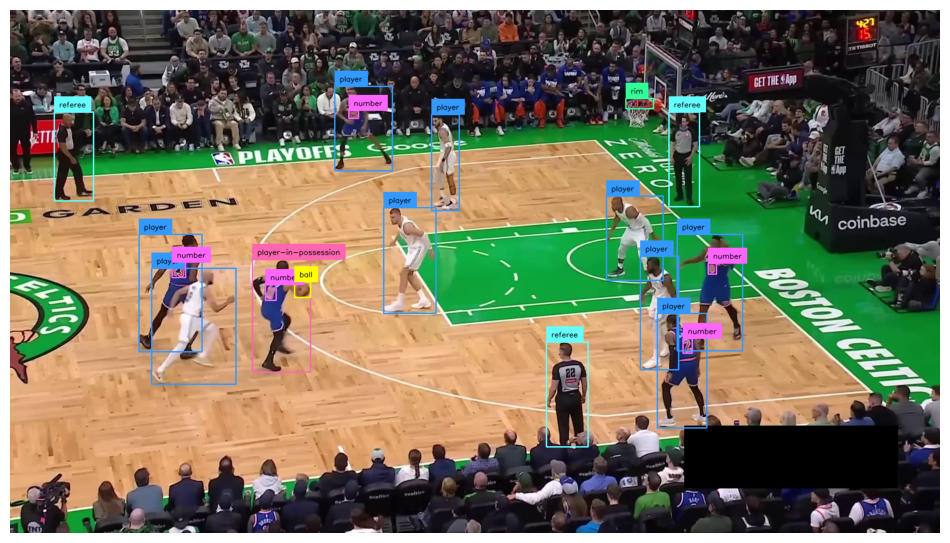

In [17]:
box_annotator = sv.BoxAnnotator(color=COLOR, thickness=2)
label_annotator = sv.LabelAnnotator(color=COLOR, text_color=sv.Color.BLACK)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
detections = sv.Detections.from_inference(result)

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections)

sv.plot_image(annotated_frame)

### Single Frame Player Detection

In [18]:
PLAYER_CLASS_IDS = [3, 4, 5, 6, 7]
# player, player-in-possession, player-jump-shot, player-layup-dunk, player-shot-block

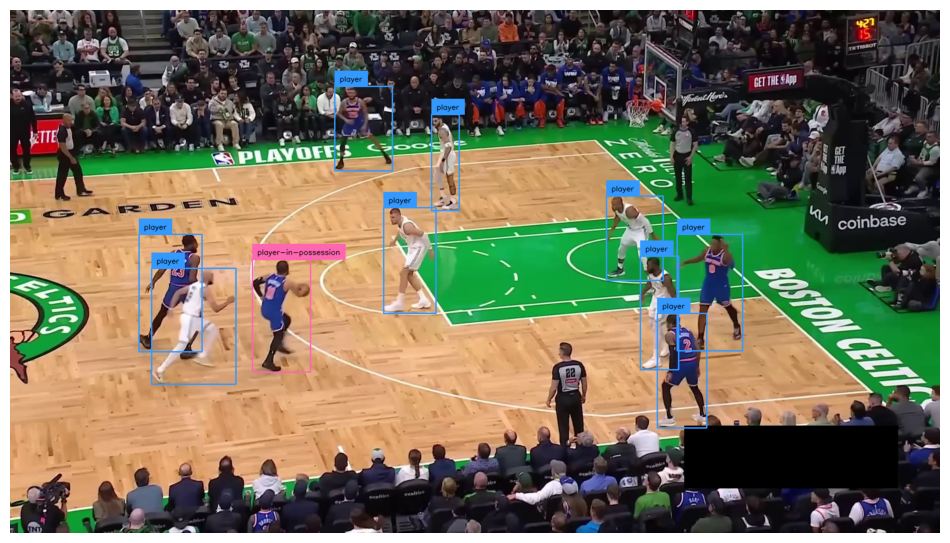

In [19]:
box_annotator = sv.BoxAnnotator(color=COLOR, thickness=2)
label_annotator = sv.LabelAnnotator(color=COLOR, text_color=sv.Color.BLACK)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections)

sv.plot_image(annotated_frame)

### Single Frame Number Detection

In [20]:
NUMBER_CLASS_ID = 2

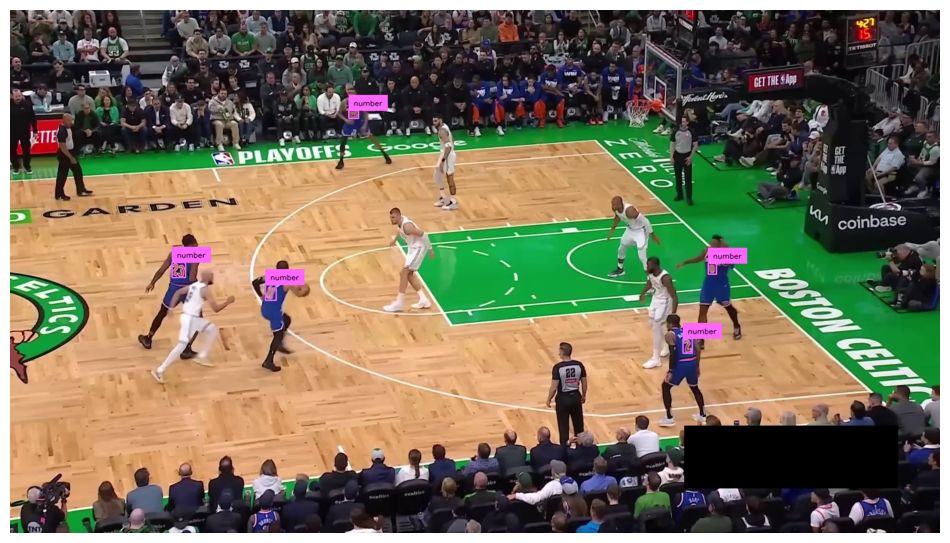

In [21]:
box_annotator = sv.BoxAnnotator(color=COLOR, thickness=2)
label_annotator = sv.LabelAnnotator(color=COLOR, text_color=sv.Color.BLACK)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
detections = sv.Detections.from_inference(result)
detections = detections[detections.class_id == NUMBER_CLASS_ID]

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections)

sv.plot_image(annotated_frame)

### Full Video Object Detection

In [22]:
TARGET_VIDEO_PATH = HOME / f"{SOURCE_VIDEO_PATH.stem}-detection{SOURCE_VIDEO_PATH.suffix}"
TARGET_VIDEO_COMPRESSED_PATH = HOME / f"{TARGET_VIDEO_PATH.stem}-detection{TARGET_VIDEO_PATH.suffix}"

box_annotator = sv.BoxAnnotator(color=COLOR, thickness=2)
label_annotator = sv.LabelAnnotator(color=COLOR, text_color=sv.Color.BLACK)

def callback(frame: np.ndarray, index: int) -> np.ndarray:
    result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
    detections = sv.Detections.from_inference(result)

    annotated_frame = frame.copy()
    annotated_frame = box_annotator.annotate(
        scene=annotated_frame,
        detections=detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame,
        detections=detections)
    return annotated_frame

sv.process_video(
    source_path=SOURCE_VIDEO_PATH,
    target_path=TARGET_VIDEO_PATH,
    callback=callback,
    show_progress=True
)

!ffmpeg -y -loglevel error -i {TARGET_VIDEO_PATH} -vcodec libx264 -crf 28 {TARGET_VIDEO_COMPRESSED_PATH}

Processing video:   0%|          | 0/238 [00:00<?, ?it/s]

In [23]:
Video(TARGET_VIDEO_COMPRESSED_PATH, embed=True, width=1080)

## Player Tracking

For this demo, to achieve the highest possible accuracy, we use the large SAM2.1 checkpoint. To speed up processing, you can switch to the `tiny`, `small`, or `base` checkpoint. This change will reduce latency but may also negatively affect tracking quality.

### Load SAM2 Tracking Model

In [33]:
%cd $HOME/segment-anything-2-real-time

from sam2.build_sam import build_sam2_camera_predictor

SAM2_CHECKPOINT = "checkpoints/sam2.1_hiera_large.pt"
SAM2_CONFIG = "configs/sam2.1/sam2.1_hiera_l.yaml"

predictor = build_sam2_camera_predictor(SAM2_CONFIG, SAM2_CHECKPOINT)

/content/segment-anything-2-real-time


### Full Video Player Tacking

Sometimes the results produced by SAM2.1 are inaccurate and contain unwanted artifacts. In short, the mask of the tracked object may also include segments that do not belong to it. To address this, we prepared a function that keeps the main segment and removes smaller segments whose centroids are farther than a given distance threshold, helping clean up noisy masks.

In [34]:
def filter_segments_by_distance(mask: np.ndarray, distance_threshold: float = 300) -> np.ndarray:
    """
    Keeps the main segment and removes segments farther than distance_threshold.

    Args:
        mask (np.ndarray): Boolean mask.
        distance_threshold (float): Maximum allowed distance from the main segment.

    Returns:
        np.ndarray: Boolean mask after filtering.
    """
    assert mask.dtype == bool, "Input mask must be boolean."
    mask_uint8 = mask.astype(np.uint8)
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask_uint8, connectivity=8)
    if num_labels <= 1:
        return mask.copy()
    main_label = 1 + np.argmax(stats[1:, cv2.CC_STAT_AREA])
    main_centroid = centroids[main_label]
    filtered_mask = np.zeros_like(mask, dtype=bool)
    for label in range(1, num_labels):
        centroid = centroids[label]
        dist = np.linalg.norm(centroid - main_centroid)
        if label == main_label or dist <= distance_threshold:
            filtered_mask[labels == label] = True
    return filtered_mask

SAM2.1 allows tracking selected objects across a video, but to do this it requires a visual prompt, such as boxes or points. In our case, we want to track all players on the court. To achieve this, we first use a fine-tuned RF-DETR model to detect all players on the first video frame, pass these detections as prompts to SAM2.1, and then track the players across the following frames.

It is worth noting that all sample videos were prepared so that every player is visible in the first frame. This ensures we can prompt SAM2.1 with detections from the first frame only, without repeating the process to include players who appear later.

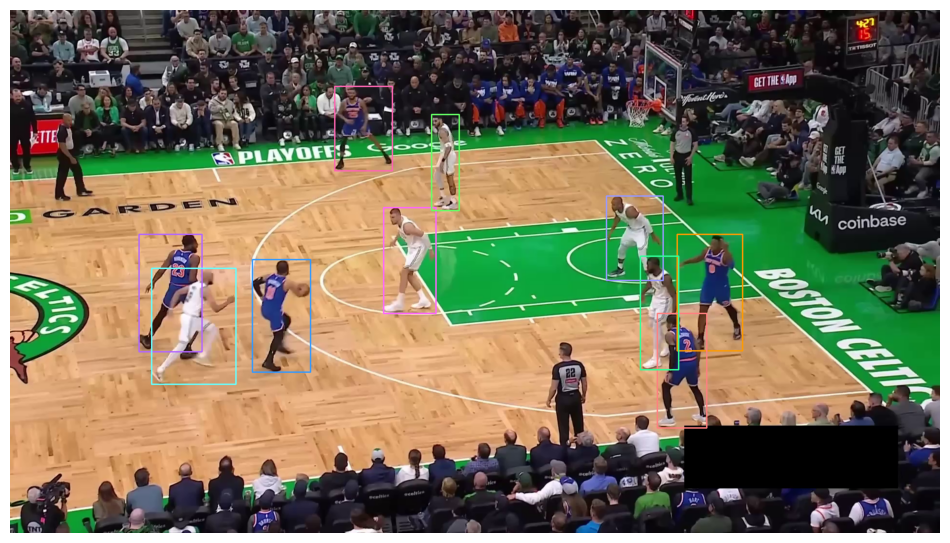

Processing video:   0%|          | 0/238 [00:00<?, ?it/s]

In [35]:
TARGET_VIDEO_PATH = HOME / f"{SOURCE_VIDEO_PATH.stem}-mask{SOURCE_VIDEO_PATH.suffix}"
TARGET_VIDEO_COMPRESSED_PATH = HOME / f"{TARGET_VIDEO_PATH.stem}-compressed{TARGET_VIDEO_PATH.suffix}"

mask_annotator = sv.MaskAnnotator(
    color=COLOR,
    color_lookup=sv.ColorLookup.TRACK,
    opacity=0.5)
box_annotator = sv.BoxAnnotator(
    color=COLOR,
    color_lookup=sv.ColorLookup.TRACK,
    thickness=2
)

# we use RF-DETR model to aquire future SAM2.1 prompt

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

# we assign each detection a tracker ID (it must be greater than 0)

TRACKE_ID = list(range(1, len(detections.class_id) + 1))
detections.tracker_id = TRACKE_ID

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(scene=annotated_frame, detections=detections)
sv.plot_image(annotated_frame)

# we prompt SAM2.1 using RF-DETR model detections

with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
    predictor.load_first_frame(frame)

    for xyxy, tracker_id in zip(detections.xyxy, detections.tracker_id):
        xyxy = np.array([xyxy])

        _, object_ids, mask_logits = predictor.add_new_prompt(
            frame_idx=0,
            obj_id=tracker_id,
            bbox=xyxy
        )

def callback(frame: np.ndarray, index: int) -> np.ndarray:
    with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
        tracker_ids, mask_logits = predictor.track(frame)
        tracker_ids = np.array(tracker_ids)
        masks = (mask_logits > 0.0).cpu().numpy()
        masks = np.squeeze(masks).astype(bool)

        masks = np.array([
            filter_segments_by_distance(mask, distance_threshold=300)
            for mask
            in masks
        ])

        detections = sv.Detections(
            xyxy=sv.mask_to_xyxy(masks=masks),
            mask=masks,
            tracker_id=tracker_ids
        )

        annotated_frame = frame.copy()
        annotated_frame = mask_annotator.annotate(scene=annotated_frame, detections=detections)
        annotated_frame = box_annotator.annotate(scene=annotated_frame, detections=detections)
        return annotated_frame

sv.process_video(
    source_path=SOURCE_VIDEO_PATH,
    target_path=TARGET_VIDEO_PATH,
    callback=callback,
    show_progress=True
)

!ffmpeg -y -loglevel error -i {TARGET_VIDEO_PATH} -vcodec libx264 -crf 28 {TARGET_VIDEO_COMPRESSED_PATH}

In [36]:
Video(TARGET_VIDEO_COMPRESSED_PATH, embed=True, width=1080)

## Cluster Players into Teams

Every basketball game is different — teams wear different uniforms, play on different courts, and have unique visual conditions. To build a general solution that works across any game while avoiding the need for manually annotating huge amounts of data, we rely on unsupervised learning.

The first step is to build our training set by going through all sample videos from our selected game. We extract one frame per second and run player detection on it. From each detection we crop the player region, then use SigLIP to generate embeddings for every crop. SigLIP is a vision-language model that produces powerful embeddings aligning images with text, making it useful for comparing visual similarity. It is important to note that we do not use the full detection bounding box for cropping. Instead, we take only the central part of the box. Depending on the player’s pose and location on the court, the bounding box may include a lot of noise, such as players from the opposing team or the crowd, which could harm the clustering results. The central crop usually contains the most relevant information about the player we want to track.

Since the embeddings are high-dimensional, we reduce them to three dimensions with UMAP, a popular algorithm for dimensionality reduction that preserves local and global structure in the data. Finally, we cluster the reduced embeddings into two groups with KMeans, a simple yet effective algorithm that partitions data points based on similarity. If everything works as expected, the crops should separate into two clusters, each representing one of the teams.

We used a similar strategy in our earlier Football AI video, so here we can reuse utilities already implemented in the `roboflow/sports` repository.

### Collecting Training Set

In [47]:
def shrink_boxes(xyxy: np.ndarray, scale: float) -> np.ndarray:
    """
    Shrinks bounding boxes by a given scale factor while keeping their centers fixed.

    Args:
        xyxy (np.ndarray): Array of shape (N, 4) containing bounding boxes in
            [x1, y1, x2, y2] format.
        scale (float): Scale factor applied to box width and height. Values
            less than 1 shrink the box, values greater than 1 enlarge it.

    Returns:
        np.ndarray: Array of shape (N, 4) with resized bounding boxes in
        [x1, y1, x2, y2] format.
    """
    x1, y1, x2, y2 = xyxy[:, 0], xyxy[:, 1], xyxy[:, 2], xyxy[:, 3]
    cx, cy = (x1 + x2) / 2, (y1 + y2) / 2
    w, h = (x2 - x1) * scale, (y2 - y1) * scale

    new_x1, new_y1 = cx - w / 2, cy - h / 2
    new_x2, new_y2 = cx + w / 2, cy + h / 2

    return np.stack([new_x1, new_y1, new_x2, new_y2], axis=1)

In [48]:
STRIDE = 30

crops = []

for video_path in sv.list_files_with_extensions(SOURCE_VIDEO_DIRECTORY, extensions=["mp4", "avi", "mov"]):
    frame_generator = sv.get_video_frames_generator(source_path=video_path, stride=STRIDE)

    for frame in tqdm(frame_generator):

        result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
        detections = sv.Detections.from_inference(result)
        detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

        boxes = shrink_boxes(xyxy=detections.xyxy, scale=0.4)
        for box in boxes:
            crops.append(sv.crop_image(frame, box))

7it [00:02,  2.37it/s]
7it [00:03,  2.25it/s]
7it [00:02,  2.84it/s]
7it [00:02,  2.56it/s]
8it [00:03,  2.60it/s]
5it [00:02,  1.84it/s]
6it [00:02,  2.82it/s]
4it [00:01,  2.79it/s]
4it [00:01,  2.70it/s]
5it [00:01,  2.59it/s]


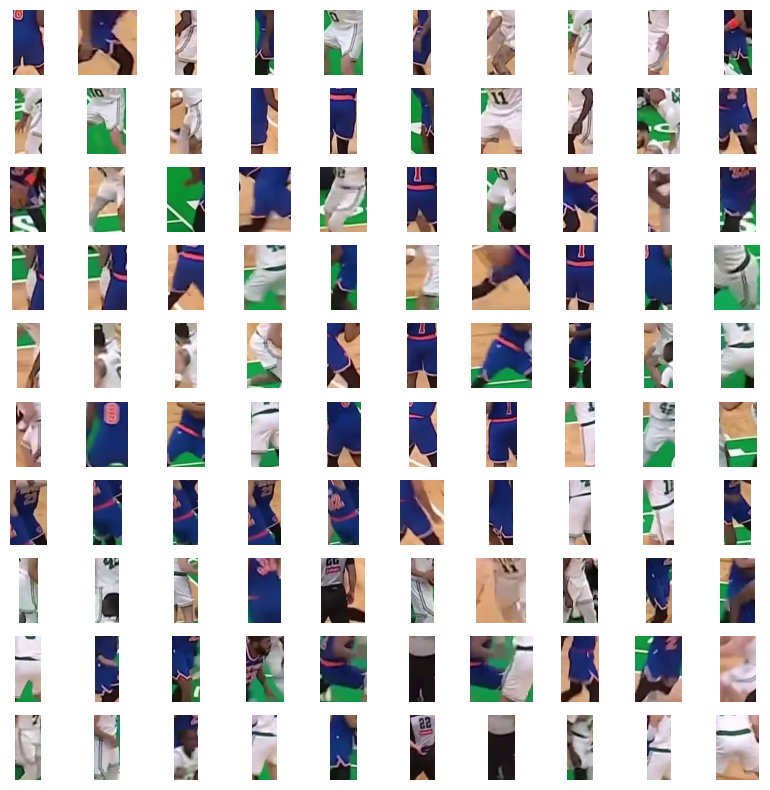

In [49]:
sv.plot_images_grid(
    images=crops[:100],
    grid_size=(10, 10),
    size=(10, 10)
)

### Train and Test Clustering Model

In [50]:
team_classifier = TeamClassifier(device="cuda")
team_classifier.fit(crops)

Embedding extraction: 19it [00:07,  2.55it/s]


Embedding extraction: 19it [00:07,  2.51it/s]


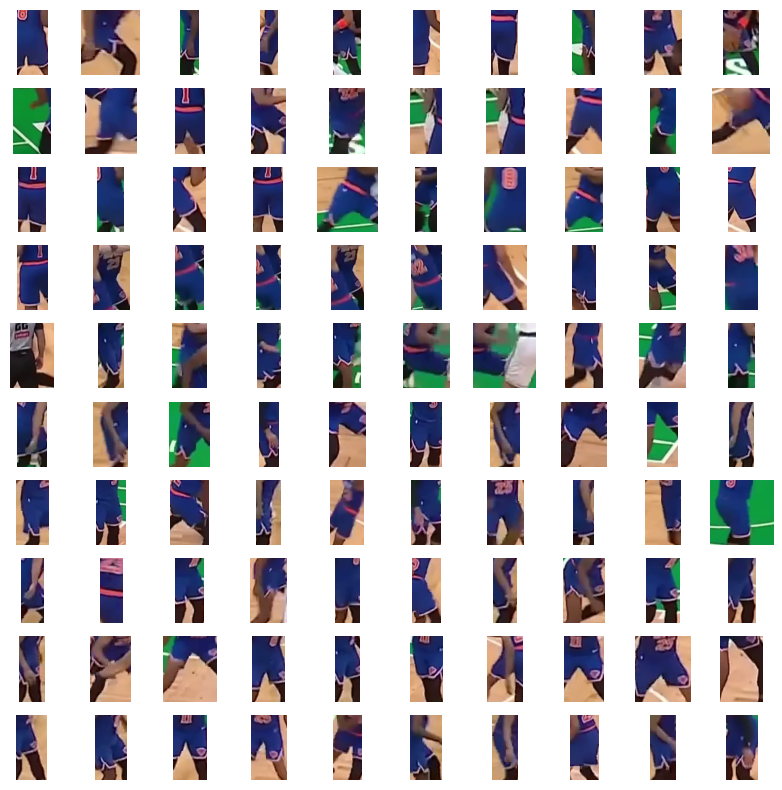

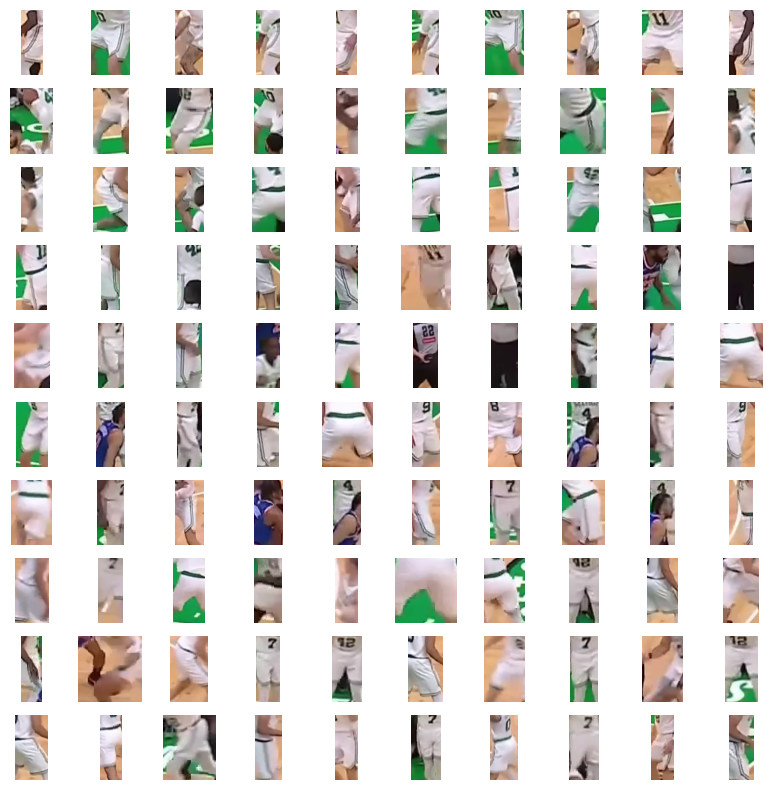

In [51]:
teams = team_classifier.predict(crops)

team_0 = [crop for crop, team in zip(crops, teams) if team == 0]
team_1 = [crop for crop, team in zip(crops, teams) if team == 1]

sv.plot_images_grid(
    images=team_0[:100],
    grid_size=(10, 10),
    size=(10, 10)
)

sv.plot_images_grid(
    images=team_1[:100],
    grid_size=(10, 10),
    size=(10, 10)
)

Embedding extraction: 1it [00:00,  6.27it/s]


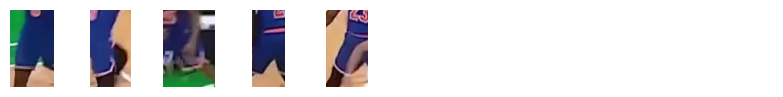

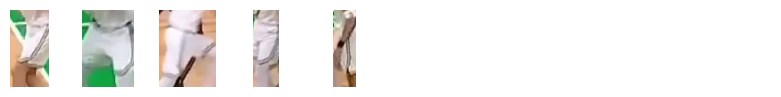

In [52]:
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

boxes = shrink_boxes(xyxy=detections.xyxy, scale=0.4)
crops = [sv.crop_image(frame, box) for box in boxes]
teams = np.array(team_classifier.predict(crops))

team_0 = [crop for crop, team in zip(crops, teams) if team == 0]
team_1 = [crop for crop, team in zip(crops, teams) if team == 1]

sv.plot_images_grid(
    images=team_0[:10],
    grid_size=(1, 10),
    size=(10, 1)
)

sv.plot_images_grid(
    images=team_1[:10],
    grid_size=(1, 10),
    size=(10, 1)
)

Since we do not control which IDs the clustering algorithm assigns to the teams, after training and testing we must select one of the dictionaries below.

In [53]:
TEAM_NAMES = {
    0: "New York Knicks",
    1: "Boston Celtics",
}

# TEAM_NAMES = {
#     0: "Boston Celtics",
#     1: "New York Knicks",
# }

### Full Video Team Clustering

In [54]:
TARGET_VIDEO_PATH = HOME / f"{SOURCE_VIDEO_PATH.stem}-teams{SOURCE_VIDEO_PATH.suffix}"
TARGET_VIDEO_COMPRESSED_PATH = HOME / f"{TARGET_VIDEO_PATH.stem}-compressed{TARGET_VIDEO_PATH.suffix}"

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# resolve team colors

color_0 = sv.Color.from_hex(TEAM_COLORS[TEAM_NAMES[0]])
color_1 = sv.Color.from_hex(TEAM_COLORS[TEAM_NAMES[1]])

mask_annotator_0 = sv.MaskAnnotator(color=color_0, opacity=0.5, color_lookup=sv.ColorLookup.INDEX)
mask_annotator_1 = sv.MaskAnnotator(color=color_1, opacity=0.5, color_lookup=sv.ColorLookup.INDEX)

box_annotator_0 = sv.BoxAnnotator(color=color_0, thickness=2, color_lookup=sv.ColorLookup.INDEX)
box_annotator_1 = sv.BoxAnnotator(color=color_1, thickness=2, color_lookup=sv.ColorLookup.INDEX)

# we use RF-DETR model to aquire future SAM2.1 prompt

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

# we assign each detection a tracker ID (it must be greater than 0)

TRACKER_ID = list(range(1, len(detections.class_id) + 1))

# we determine the team for each player and assign a team ID to every detection

boxes = shrink_boxes(xyxy=detections.xyxy, scale=0.4)
crops = [sv.crop_image(frame, box) for box in boxes]
TEAMS = np.array(team_classifier.predict(crops))

# we prompt SAM2.1 using RF-DETR model detections

with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
    predictor.load_first_frame(frame)

    for xyxy, tracker_id in zip(detections.xyxy, TRACKER_ID):
        xyxy = np.array([xyxy])

        _, object_ids, mask_logits = predictor.add_new_prompt(
            frame_idx=0,
            obj_id=tracker_id,
            bbox=xyxy
        )

def callback(frame: np.ndarray, index: int) -> np.ndarray:
    with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
        tracker_ids, mask_logits = predictor.track(frame)
        tracker_ids = np.array(tracker_ids)
        masks = (mask_logits > 0.0).cpu().numpy()
        masks = np.squeeze(masks).astype(bool)

        masks = np.array([
            filter_segments_by_distance(mask, distance_threshold=300)
            for mask
            in masks
        ])

        detections = sv.Detections(
            xyxy=sv.mask_to_xyxy(masks=masks),
            mask=masks,
            tracker_id=tracker_ids
        )

        detections_0 = detections[TEAMS == 0]
        detections_1 = detections[TEAMS == 1]

        annotated_frame = frame.copy()
        annotated_frame = mask_annotator_0.annotate(
            scene=annotated_frame,
            detections=detections_0
        )
        annotated_frame = mask_annotator_1.annotate(
            scene=annotated_frame,
            detections=detections_1
        )

        annotated_frame = box_annotator_0.annotate(
            scene=annotated_frame,
            detections=detections_0
        )
        annotated_frame = box_annotator_1.annotate(
            scene=annotated_frame,
            detections=detections_1
        )
        return annotated_frame

sv.process_video(
    source_path=SOURCE_VIDEO_PATH,
    target_path=TARGET_VIDEO_PATH,
    callback=callback,
    show_progress=True
)

!ffmpeg -y -loglevel error -i {TARGET_VIDEO_PATH} -vcodec libx264 -crf 28 {TARGET_VIDEO_COMPRESSED_PATH}

Embedding extraction: 1it [00:00,  5.33it/s]


Processing video:   0%|          | 0/238 [00:00<?, ?it/s]

In [55]:
Video(TARGET_VIDEO_COMPRESSED_PATH, embed=True, width=1080)

## Read Player Numbers

### Load Number Recognition Model

Reading player numbers from small and blurry crops is not easy. Traditional OCR models struggle with this task. For this reason, we decided to use SmolVLM2, fine-tuned on a custom multi-modal dataset.

The dataset contains jersey number crops collected from the 2025 NBA Playoffs. These numbers were first auto-annotated using a pre-trained SmolVLM2 model, then manually refined. Finally, a LoRA adapter was trained on the dataset, which we now load for inference.

In [66]:
NUMBER_RECOGNITION_MODEL_ID = "basketball-jersey-numbers-ocr/3"
NUMBER_RECOGNITION_MODEL = get_model(model_id=NUMBER_RECOGNITION_MODEL_ID)
NUMBER_RECOGNITION_MODEL_PROMPT = "Read the number."

### Single Frame Player Number Detection and Recognition

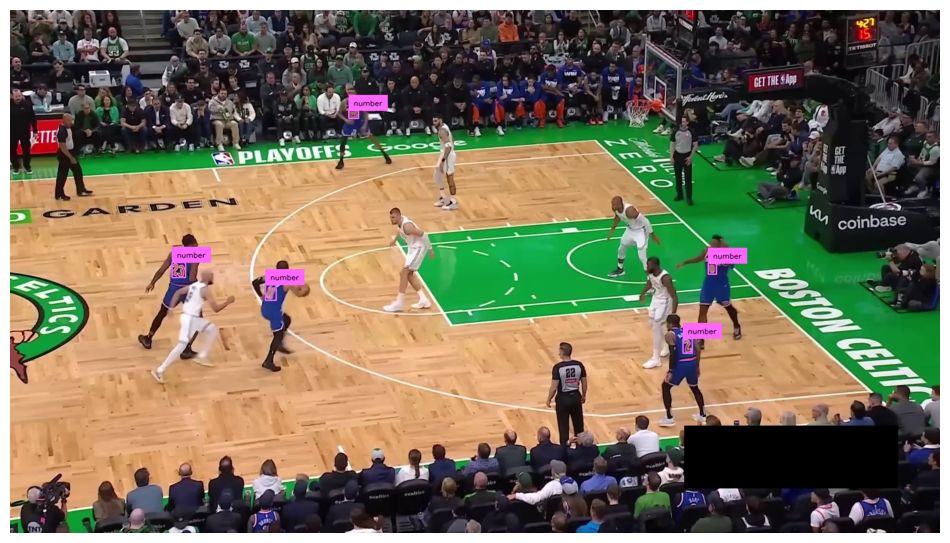

In [69]:
box_annotator = sv.BoxAnnotator(color=COLOR, thickness=2)
label_annotator = sv.LabelAnnotator(color=COLOR, text_color=sv.Color.BLACK)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)
frame_h, frame_w, *_ = frame.shape

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
detections = sv.Detections.from_inference(result)
detections = detections[detections.class_id == NUMBER_CLASS_ID]

annotated_frame = frame.copy()
annotated_frame = box_annotator.annotate(
    scene=annotated_frame,
    detections=detections)
annotated_frame = label_annotator.annotate(
    scene=annotated_frame,
    detections=detections)

sv.plot_image(annotated_frame)

In [70]:
crops = [
    sv.crop_image(frame, xyxy)
    for xyxy
    in sv.clip_boxes(sv.pad_boxes(xyxy=detections.xyxy, px=10, py=10), (frame_w, frame_h))
]
numbers = [
    NUMBER_RECOGNITION_MODEL.predict(crop, NUMBER_RECOGNITION_MODEL_PROMPT)[0]
    for crop
    in crops
]

sv.plot_images_grid(
    images=crops[:10],
    titles=numbers[:10],
    grid_size=(1, 10),
    size=(10, 1)
)

RuntimeError: FlashAttention only supports Ampere GPUs or newer.

### Single Frame Player Detection with Number Detection Matching

The next challenge is to assign each detected jersey number to the correct tracked player. To achieve this, we use the mask IoS metric.

IoS is similar to IoU, but with one key difference. While IoU measures the overlap ratio relative to the union of two areas, IoS measures the overlap relative to the smaller area. This means that if a smaller object is completely inside a larger one, IoS equals 1.

We use masks instead of bounding boxes because they provide much more accurate matches. The process is similar to player tracking: we first detect players in the initial video frame using RF-DETR, then track them across frames with SAM2.1. As a result, for every video frame we obtain precise segmentation masks for each player. Next, we run RF-DETR again, this time to detect jersey numbers on each frame. We convert the number bounding boxes into masks and then compute batch IoS between player masks and number masks. Finally, we keep only pairs with an almost perfect overlap (0.9 or higher). By selecting the indices of the corresponding rows and columns, we determine which player detections and jersey number detections belong together.

In [ ]:
def xyxy_to_mask(boxes: np.ndarray, resolution_wh: Tuple[int, int]) -> np.ndarray:
    """
    Converts a 2D `np.ndarray` of bounding boxes into a 3D `np.ndarray` of bool masks.

    Parameters:
        boxes (np.ndarray): A 2D `np.ndarray` of shape `(N, 4)`
            containing bounding boxes `(x_min, y_min, x_max, y_max)`
        resolution_wh (Tuple[int, int]): A tuple `(width, height)` specifying
            the resolution of the output masks

    Returns:
        np.ndarray: A 3D `np.ndarray` of shape `(N, height, width)`
            containing 2D bool masks for each bounding box
    """
    width, height = resolution_wh
    n = boxes.shape[0]
    masks = np.zeros((n, height, width), dtype=bool)

    for i, (x_min, y_min, x_max, y_max) in enumerate(boxes):
        # Clip values to image resolution
        x_min = max(0, int(x_min))
        y_min = max(0, int(y_min))
        x_max = min(width - 1, int(x_max))
        y_max = min(height - 1, int(y_max))

        if x_max >= x_min and y_max >= y_min:
            masks[i, y_min:y_max + 1, x_min:x_max + 1] = True

    return masks

In [ ]:
def coords_above_threshold(
    matrix: np.ndarray, threshold: float, sort_desc: bool = True
) -> List[Tuple[int, int]]:
    """
    Return all (row_index, col_index) where value > threshold.
    Rows and columns may repeat.
    Optionally sort by value descending.
    """
    A = np.asarray(matrix)
    rows, cols = np.where(A > threshold)
    pairs = list(zip(rows.tolist(), cols.tolist()))
    if sort_desc:
        pairs.sort(key=lambda rc: A[rc[0], rc[1]], reverse=True)
    return pairs

0it [00:00, ?it/s]

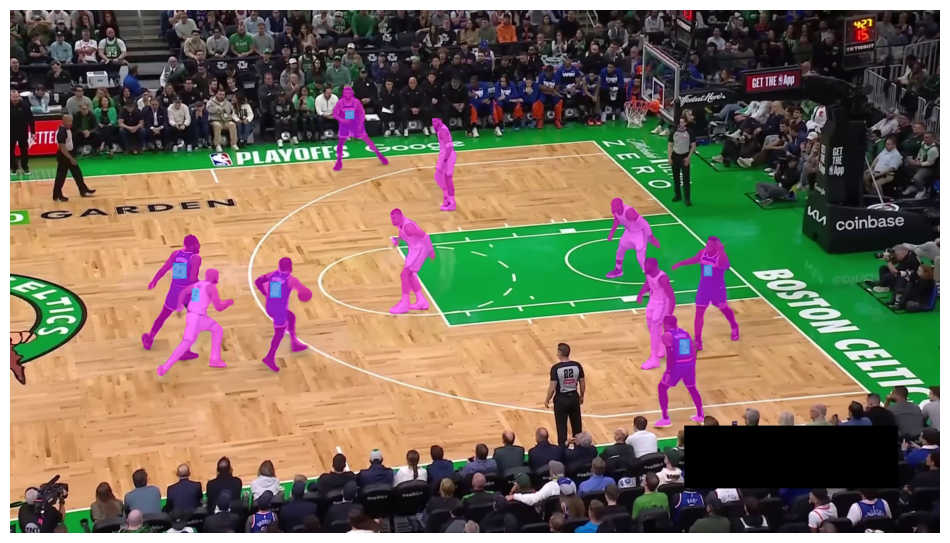

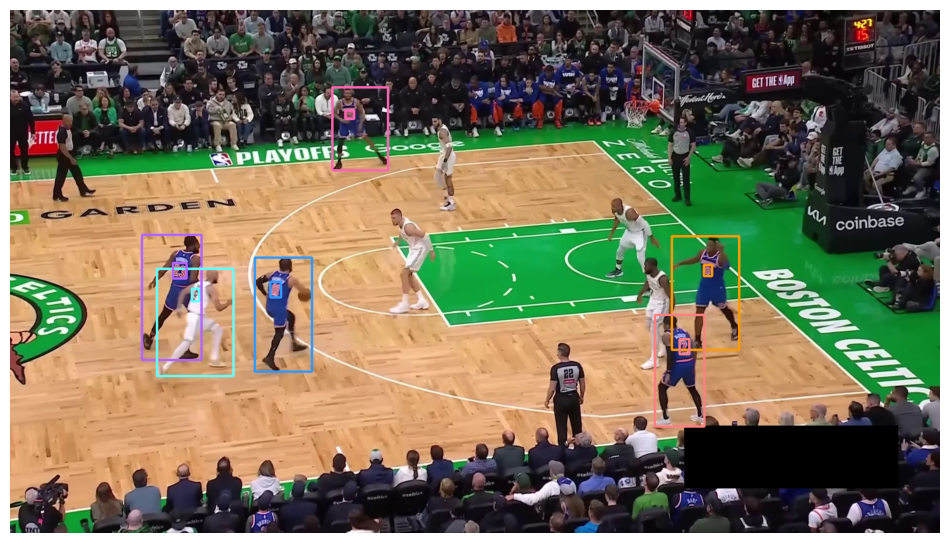

1it [00:01,  1.39s/it]


In [ ]:
frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

box_annotator = sv.BoxAnnotator(color=COLOR, thickness=4, color_lookup=sv.ColorLookup.TRACK)

mask_annotator_player = sv.MaskAnnotator(color=sv.Color.from_hex("#ff00ff"), opacity=0.5, color_lookup=sv.ColorLookup.INDEX)
mask_annotator_number = sv.MaskAnnotator(color=sv.Color.from_hex("#00ffff"), opacity=0.5, color_lookup=sv.ColorLookup.INDEX)

# we use RF-DETR model to aquire future SAM2.1 prompt

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

# we assign each detection a tracker ID (it must be greater than 0)

TRACKE_ID = list(range(1, len(detections.class_id) + 1))

# we prompt SAM2.1 using RF-DETR model detections

with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
    predictor.load_first_frame(frame)

    for xyxy, tracker_id in zip(detections.xyxy, TRACKE_ID):
        xyxy = np.array([xyxy])

        _, object_ids, mask_logits = predictor.add_new_prompt(
            frame_idx=0,
            obj_id=tracker_id,
            bbox=xyxy
        )

for index, frame in tqdm(enumerate(frame_generator)):

    # we only process the first video frame

    if index > 0:
        break

    frame_h, frame_w, *_ = frame.shape

    with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
        tracker_ids, mask_logits = predictor.track(frame)
        tracker_ids = np.array(tracker_ids)
        masks = (mask_logits > 0.0).cpu().numpy()
        masks = np.squeeze(masks).astype(bool)

        player_masks = np.array([
            filter_segments_by_distance(mask, distance_threshold=300)
            for mask
            in masks
        ])

        player_detections = sv.Detections(
            xyxy=sv.mask_to_xyxy(masks=player_masks),
            mask=player_masks,
            tracker_id=tracker_ids
        )

        # we use RF-DETR model to detect numbers

        result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
        number_detections = sv.Detections.from_inference(result)
        number_detections = number_detections[number_detections.class_id == NUMBER_CLASS_ID]
        number_detections.mask = xyxy_to_mask(boxes=number_detections.xyxy, resolution_wh=(frame_w, frame_h))

        # we use mask IoS to match numbers with players

        iou = sv.mask_iou_batch(
            masks_true=player_masks,
            masks_detection=number_detections.mask,
            overlap_metric=sv.OverlapMetric.IOS
        )

        pairs = coords_above_threshold(iou, 0.9)
        player_idx, number_idx = zip(*pairs)

        annotated_frame = frame.copy()
        annotated_frame = mask_annotator_player.annotate(
            scene=annotated_frame,
            detections=player_detections)
        annotated_frame = mask_annotator_number.annotate(
            scene=annotated_frame,
            detections=number_detections)
        sv.plot_image(annotated_frame)

        player_detections = player_detections[np.array(player_idx)]
        number_detections = number_detections[np.array(number_idx)]
        number_detections.tracker_id = player_detections.tracker_id

        annotated_frame = frame.copy()
        annotated_frame = box_annotator.annotate(
            scene=annotated_frame,
            detections=player_detections)
        annotated_frame = box_annotator.annotate(
            scene=annotated_frame,
            detections=number_detections)
        sv.plot_image(annotated_frame)

### Validating Recognized Numbers

Since the players’ positions relative to the camera are constantly changing, the visibility of their jersey numbers also varies. It is therefore unwise to rely on a single prediction from the number recognition model. Under certain conditions, a 2 may be misread as a 7, and 23 may be mistaken for 2, 3, or 25. Validation of the recognized number across multiple samples is necessary. To increase confidence, we require three identical results across consecutive predictions.

We also introduce spacing between individual predictions. First, because each prediction using SmolVLM2 is relatively expensive. Second, to ensure sufficient variation in the player’s position relative to the camera between samples. In particular, running predictions on consecutive frames makes little sense, as the player’s position is likely almost unchanged.

In [ ]:
Value = Union[int, str, None]


class PropertyValidator:
    """
    Validate a property per tracker_id after N consecutive identical reports.
    Once validated, the assignment stays fixed until reset.
    """

    def __init__(self, n_consecutive: int):
        if n_consecutive < 1:
            raise ValueError("n_consecutive must be >= 1")
        self.n = n_consecutive
        self._streak: Dict[int, int] = {}
        self._last: Dict[int, Optional[str]] = {}
        self._validated: Dict[int, Optional[str]] = {}

    def reset_id(self, tracker_id: int) -> None:
        self._streak.pop(tracker_id, None)
        self._last.pop(tracker_id, None)
        self._validated.pop(tracker_id, None)

    def reset_all(self) -> None:
        self._streak.clear()
        self._last.clear()
        self._validated.clear()

    def _normalize(self, value: Value) -> Optional[str]:
        if value is None:
            return None
        s = str(value).strip()
        return s if s else None

    def update(self, tracker_ids: List[int], values: List[Value]) -> List[Optional[str]]:
        if len(tracker_ids) != len(values):
            raise ValueError("tracker_ids and values must have the same length")

        output: List[Optional[str]] = []

        for tid, raw in zip(tracker_ids, values):
            if tid in self._validated and self._validated[tid] is not None:
                output.append(self._validated[tid])
                continue

            val = self._normalize(raw)

            if val is None:
                output.append(None)
                self._streak.setdefault(tid, 0)
                self._last.setdefault(tid, None)
                self._validated.setdefault(tid, None)
                continue

            last = self._last.get(tid)

            if last == val:
                self._streak[tid] = self._streak.get(tid, 0) + 1
            else:
                self._streak[tid] = 1
                self._last[tid] = val

            if self._streak[tid] >= self.n:
                self._validated[tid] = self._last[tid]

            output.append(self._validated.get(tid))
            self._last.setdefault(tid, val)
            self._validated.setdefault(tid, None)

        return output

    def get_validated(
        self, tracker_ids: int | Iterable[int]
    ) -> Optional[str] | List[Optional[str]]:
        """
        Query validated properties for one or many tracker_ids.

        Args:
            tracker_ids (int | Iterable[int]): Single tracker_id or an
                iterable of tracker_ids.

        Returns:
            Optional[str] | List[Optional[str]]:
                Single validated value if input is an int.
                List of validated values in input order if iterable.
        """
        if isinstance(tracker_ids, int):
            return self._validated.get(tracker_ids)
        return [self._validated.get(tid) for tid in tracker_ids]

    def validated_dict(self) -> Dict[int, str]:
        """
        Snapshot of validated assignments. Excludes None values.
        """
        return {tid: val for tid, val in self._validated.items() if val is not None}

In [ ]:
TARGET_VIDEO_PATH = HOME / f"{SOURCE_VIDEO_PATH.stem}-validated-numbers{SOURCE_VIDEO_PATH.suffix}"
TARGET_VIDEO_COMPRESSED_PATH = HOME / f"{TARGET_VIDEO_PATH.stem}-compressed{TARGET_VIDEO_PATH.suffix}"

number_validator = PropertyValidator(n_consecutive=3)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

mask_annotator = sv.MaskAnnotator(
    color=COLOR,
    color_lookup=sv.ColorLookup.TRACK,
    opacity=0.7)
box_annotator = sv.BoxAnnotator(
    color=COLOR,
    color_lookup=sv.ColorLookup.TRACK,
    thickness=2)
label_annotator = sv.LabelAnnotator(
    color=COLOR,
    color_lookup=sv.ColorLookup.TRACK,
    text_color=sv.Color.BLACK,
    text_scale=0.8)

# we use RF-DETR model to aquire future SAM2.1 prompt

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

# we assign each detection a tracker ID (it must be greater than 0)

TRACKE_ID = list(range(1, len(detections.class_id) + 1))

# we prompt SAM2.1 using RF-DETR model detections

with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
    predictor.load_first_frame(frame)

    for xyxy, tracker_id in zip(detections.xyxy, TRACKE_ID):
        xyxy = np.array([xyxy])

        _, object_ids, mask_logits = predictor.add_new_prompt(
            frame_idx=0,
            obj_id=tracker_id,
            bbox=xyxy
        )

def callback(frame: np.ndarray, index: int) -> np.ndarray:

    frame_h, frame_w, *_ = frame.shape

    with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
        tracker_ids, mask_logits = predictor.track(frame)
        tracker_ids = np.array(tracker_ids)
        masks = (mask_logits > 0.0).cpu().numpy()
        masks = np.squeeze(masks).astype(bool)

        player_masks = np.array([
            filter_segments_by_distance(mask, distance_threshold=300)
            for mask
            in masks
        ])

        player_detections = sv.Detections(
            xyxy=sv.mask_to_xyxy(masks=player_masks),
            mask=player_masks,
            tracker_id=tracker_ids
        )

        # we perform number recognition at specific frame intervals.
        if index % 5 == 0:

            # we use RF-DETR model to detect numbers

            result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
            number_detections = sv.Detections.from_inference(result)
            number_detections = number_detections[number_detections.class_id == NUMBER_CLASS_ID]
            number_detections.mask = xyxy_to_mask(boxes=number_detections.xyxy, resolution_wh=(frame_w, frame_h))

            # we crop out numbers detection and run recognition model

            number_crops = [
                sv.crop_image(frame, xyxy)
                for xyxy
                in sv.clip_boxes(sv.pad_boxes(xyxy=number_detections.xyxy, px=10, py=10), (frame_w, frame_h))
            ]
            numbers = [
                NUMBER_RECOGNITION_MODEL.predict(number_crop, NUMBER_RECOGNITION_MODEL_PROMPT)[0]
                for number_crop
                in number_crops
            ]

            # we use mask IoS to match numbers with players

            iou = sv.mask_iou_batch(
                masks_true=player_masks,
                masks_detection=number_detections.mask,
                overlap_metric=sv.OverlapMetric.IOS
            )

            pairs = coords_above_threshold(iou, 0.9)
            player_idx, number_idx = zip(*pairs)
            player_idx = [i + 1 for i in player_idx]
            number_idx = list(number_idx)

            # we update number validator state

            numbers = [numbers[int(i)] for i in number_idx]
            number_validator.update(tracker_ids=player_idx, values=numbers)

        # we visualize boxes and masks

        annotated_frame = frame.copy()
        annotated_frame = mask_annotator.annotate(
            scene=annotated_frame,
            detections=player_detections)
        annotated_frame = box_annotator.annotate(
            scene=annotated_frame,
            detections=player_detections)

        # we extract validated numbers

        numbers = number_validator.get_validated(tracker_ids=player_detections.tracker_id)

        # we visualize numbers

        validated_numbers_mask = [
            number is not None
            for number
            in numbers
        ]

        player_detections = player_detections[validated_numbers_mask]

        labels = [
            numbers
            for numbers
            in numbers
            if numbers is not None
        ]

        annotated_frame = label_annotator.annotate(
            scene=annotated_frame,
            detections=player_detections,
            labels=labels)

        return annotated_frame

sv.process_video(
    source_path=SOURCE_VIDEO_PATH,
    target_path=TARGET_VIDEO_PATH,
    callback=callback,
    show_progress=True
)

!ffmpeg -y -loglevel error -i {TARGET_VIDEO_PATH} -vcodec libx264 -crf 28 {TARGET_VIDEO_COMPRESSED_PATH}

In [ ]:
Video(TARGET_VIDEO_COMPRESSED_PATH, embed=True, width=1080)

## Putting Everything Together

In [56]:
!gdown https://drive.google.com/drive/folders/1RBjpI5Xleb58lujeusxH0W5zYMMA4ytO -O {HOME / "fonts"} --folder

Retrieving folder contents
Processing file 1D2JPj8CxzQT7L2VrrDOmxXX0sqCRUjFU Bayon-Regular.ttf
Processing file 1hCpPlFwxhtLLtoeuOhKsjcvXoGsGJEi0 ConcertOne-Regular.ttf
Processing file 1PE8V1I42Cd0OS5ApDIpHOQSFxjkLg5aC SquadaOne-Regular.ttf
Processing file 13DU0TYTgXtFfO02y-5lgQpzc1PSUA5WE Staatliches-Regular.ttf
Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1D2JPj8CxzQT7L2VrrDOmxXX0sqCRUjFU
To: /content/fonts/Bayon-Regular.ttf
100% 54.6k/54.6k [00:00<00:00, 98.2MB/s]
Downloading...
From: https://drive.google.com/uc?id=1hCpPlFwxhtLLtoeuOhKsjcvXoGsGJEi0
To: /content/fonts/ConcertOne-Regular.ttf
100% 70.0k/70.0k [00:00<00:00, 101MB/s]
Downloading...
From: https://drive.google.com/uc?id=1PE8V1I42Cd0OS5ApDIpHOQSFxjkLg5aC
To: /content/fonts/SquadaOne-Regular.ttf
100% 17.8k/17.8k [00:00<00:00, 63.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=13DU0TYTgXtFfO02y-5lgQpzc1PSU

In [58]:
frames_history = []
detections_history = []

number_validator = PropertyValidator(n_consecutive=3)
team_validator = PropertyValidator(n_consecutive=1)

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
frame = next(frame_generator)

# we use RF-DETR model to aquire future SAM2.1 prompt

result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD, class_agnostic_nms=True)[0]
detections = sv.Detections.from_inference(result)
detections = detections[np.isin(detections.class_id, PLAYER_CLASS_IDS)]

# we assign each detection a tracker ID (it must be greater than 0)

TRACKER_ID = list(range(1, len(detections.class_id) + 1))

# we determine the team for each player and assign a team ID to every detection

boxes = shrink_boxes(xyxy=detections.xyxy, scale=0.4)
crops = [sv.crop_image(frame, box) for box in boxes]
TEAMS = np.array(team_classifier.predict(crops))

team_validator.update(tracker_ids=TRACKER_ID, values=TEAMS)

# we prompt SAM2.1 using RF-DETR model detections

with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
    predictor.load_first_frame(frame)

    for xyxy, tracker_id in zip(detections.xyxy, TRACKER_ID):
        xyxy = np.array([xyxy])

        _, object_ids, mask_logits = predictor.add_new_prompt(
            frame_idx=0,
            obj_id=tracker_id,
            bbox=xyxy
        )

frame_generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)

for index, frame in tqdm(enumerate(frame_generator)):

    frame_h, frame_w, *_ = frame.shape

    with torch.inference_mode(), torch.autocast("cuda", dtype=torch.bfloat16):
        tracker_ids, mask_logits = predictor.track(frame)
        tracker_ids = np.array(tracker_ids)
        masks = (mask_logits > 0.0).cpu().numpy()
        masks = np.squeeze(masks).astype(bool)

        player_masks = np.array([
            filter_segments_by_distance(mask, distance_threshold=300)
            for mask
            in masks
        ])

        player_detections = sv.Detections(
            xyxy=sv.mask_to_xyxy(masks=player_masks),
            mask=player_masks,
            tracker_id=tracker_ids
        )

        frames_history.append(frame)
        detections_history.append(player_detections)

        # we perform number recognition at specific frame intervals.
        if index % 5 == 0:

            # we use RF-DETR model to detect numbers

            result = PLAYER_DETECTION_MODEL.infer(frame, confidence=PLAYER_DETECTION_MODEL_CONFIDENCE, iou_threshold=PLAYER_DETECTION_MODEL_IOU_THRESHOLD)[0]
            number_detections = sv.Detections.from_inference(result)
            number_detections = number_detections[number_detections.class_id == NUMBER_CLASS_ID]
            number_detections.mask = xyxy_to_mask(boxes=number_detections.xyxy, resolution_wh=(frame_w, frame_h))

            # we crop out numbers detection and run recognition model

            number_crops = [
                sv.crop_image(frame, xyxy)
                for xyxy
                in sv.clip_boxes(sv.pad_boxes(xyxy=number_detections.xyxy, px=10, py=10), (frame_w, frame_h))
            ]
            numbers = [
                NUMBER_RECOGNITION_MODEL.predict(number_crop, NUMBER_RECOGNITION_MODEL_PROMPT)[0]
                for number_crop
                in number_crops
            ]

            # we use mask IoS to match numbers with players

            iou = sv.mask_iou_batch(
                masks_true=player_masks,
                masks_detection=number_detections.mask,
                overlap_metric=sv.OverlapMetric.IOS
            )

            pairs = coords_above_threshold(iou, 0.9)

            if len(pairs) == 0:
                continue

            player_idx, number_idx = zip(*pairs)
            player_idx = [i + 1 for i in player_idx]
            number_idx = list(number_idx)

            # we update number validator state

            numbers = [numbers[int(i)] for i in number_idx]
            number_validator.update(tracker_ids=player_idx, values=numbers)

NameError: name 'PropertyValidator' is not defined

In [ ]:
TARGET_VIDEO_PATH = HOME / f"{SOURCE_VIDEO_PATH.stem}-result{SOURCE_VIDEO_PATH.suffix}"
TARGET_VIDEO_COMPRESSED_PATH = HOME / f"{TARGET_VIDEO_PATH.stem}-compressed{TARGET_VIDEO_PATH.suffix}"

video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)

team_colors = sv.ColorPalette.from_hex([
    TEAM_COLORS[TEAM_NAMES[0]],
    TEAM_COLORS[TEAM_NAMES[1]]
])

team_mask_annotator = sv.MaskAnnotator(
    color=team_colors,
    opacity=0.5,
    color_lookup=sv.ColorLookup.INDEX)
team_label_annotator = sv.RichLabelAnnotator(
    font_path=f"{HOME}/fonts/Staatliches-Regular.ttf",
    font_size=40,
    color=team_colors,
    text_color=sv.Color.WHITE,
    text_position=sv.Position.BOTTOM_CENTER,
    text_offset=(0, 10),
    color_lookup=sv.ColorLookup.INDEX)

with sv.VideoSink(TARGET_VIDEO_PATH, video_info) as sink:
    for frame, detections in tqdm(zip(frames_history, detections_history)):
        detections = detections[detections.area > 100]

        teams = team_validator.get_validated(tracker_ids=detections.tracker_id)
        teams = np.array(teams).astype(int)
        numbers = number_validator.get_validated(tracker_ids=detections.tracker_id)
        numbers = np.array(numbers)

        labels = [
            f"#{number} {TEAM_ROSTERS[TEAM_NAMES[team]].get(number)}"
            for number, team
            in zip(numbers, teams)
        ]

        annotated_frame = frame.copy()
        annotated_frame = team_mask_annotator.annotate(
            scene=annotated_frame,
            detections=detections,
            custom_color_lookup=teams)
        annotated_frame = team_label_annotator.annotate(
            scene=annotated_frame,
            detections=detections,
            labels=labels,
            custom_color_lookup=teams)

        sink.write_frame(annotated_frame)

!ffmpeg -y -loglevel error -i {TARGET_VIDEO_PATH} -vcodec libx264 -crf 28 {TARGET_VIDEO_COMPRESSED_PATH}

238it [00:33,  7.05it/s]


In [ ]:
Video(TARGET_VIDEO_COMPRESSED_PATH, embed=True, width=1080)

<div align="center">
  <p>
    Looking for more tutorials or have questions?
    Check out our <a href="https://github.com/roboflow/notebooks">GitHub repo</a> for more notebooks,
    or visit our <a href="https://discord.gg/GbfgXGJ8Bk">discord</a>.
  </p>
  
  <p>
    <strong>If you found this helpful, please consider giving us a ⭐
    <a href="https://github.com/roboflow/notebooks">on GitHub</a>!</strong>
  </p>

</div>